the purpose of this notebook is to explore predictions of models.

In [100]:
import os, glob, bcolz, gc

import numpy as np
import pandas as pd

from tqdm import tqdm
from scipy import ndimage, misc

from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import roc_auc_score, accuracy_score, log_loss
from sklearn.preprocessing import MinMaxScaler

from keras import backend as K
from keras import optimizers
from keras.models import Model, load_model
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator, random_rotation, random_shear, random_zoom, random_shift, flip_axis

from keras.layers.normalization import BatchNormalization
from keras.layers import Dense, Dropout, Flatten, Activation, Input, concatenate, add, GlobalAveragePooling2D, ZeroPadding2D
from keras.layers.convolutional import MaxPooling2D, Convolution2D, AveragePooling2D
from keras.layers.advanced_activations import PReLU, LeakyReLU

from keras.applications.vgg19 import VGG19
from keras.applications.resnet50 import ResNet50
from keras.applications.inception_v3 import InceptionV3
from keras.applications.xception import Xception
from keras.applications.inception_v3 import preprocess_input as preprocess_input_incep_xcep
from keras.applications.imagenet_utils import preprocess_input as preprocess_input_vgg_resnet

%matplotlib inline
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/cpu:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 12318923479941891096, name: "/gpu:0"
 device_type: "GPU"
 memory_limit: 312213504
 locality {
   bus_id: 2
 }
 incarnation: 197821450118142569
 physical_device_desc: "device: 0, name: Tesla K80, pci bus id: 0000:85:00.0"]

In [2]:
path = os.path.join('/scratch', 'yns207', 'data_invasive')
test_path = os.path.join(path, 'test')
results_path = os.path.join(path, 'results')
train_path = os.path.join(path, 'train')
valid_path = os.path.join(path, 'valid')

In [3]:
train_set = pd.read_csv(os.path.join(path, 'train_labels.csv'))
test_set = pd.read_csv(os.path.join(path, 'sample_submission.csv'))

def read_img(img_path, img_shape):
    img = misc.imread(img_path)
    img = misc.imresize(img, img_shape)
    return img

def read_imgs(img_height, img_width):
    train_img, test_img = [],[]
    for img_path in tqdm(train_set['name'].iloc[:]):
        train_img.append(read_img(os.path.join(path, 'train', str(img_path)+'.jpg'), (img_height, img_width)))

    for img_path in tqdm(test_set['name'].iloc[:]):
        test_img.append(read_img(os.path.join(path, 'test', str(img_path)+'.jpg'), (img_height, img_width)))
    return np.array(train_img), np.array(test_img)

train_img, test_img = read_imgs(300,400)

100%|██████████| 1531/1531 [00:53<00:00, 28.60it/s]


In [4]:
train_labels = train_set['invasive'].values

# invasive_customconv_aug7_1.model (no label smoothing)

In [105]:
model_path = os.path.join(path,'invasive_customincep_aug7_1.model')
model = load_model(model_path)

In [106]:
proc_train_img = preprocess_input_incep_xcep(train_img.astype(np.float32))
model.evaluate(proc_train_img, train_labels)

2295/2295 [==============================] - 27s      

[0.15313223828936973, 0.98692810457516345]

In [107]:
preds = model.predict(proc_train_img)

In [108]:
# incorrectly classified
diffs = np.abs(train_labels - preds.flatten())
sig_diff_idxs = np.array([i for i,diff in enumerate(diffs) if diff > 0.5])
sig_diff_idxs.shape

(30,)

In [109]:
# correctly classified
insig_diff_idxs = np.array([i for i,diff in enumerate(diffs) if diff < 0.5])
insig_diff_idxs.shape

(2265,)

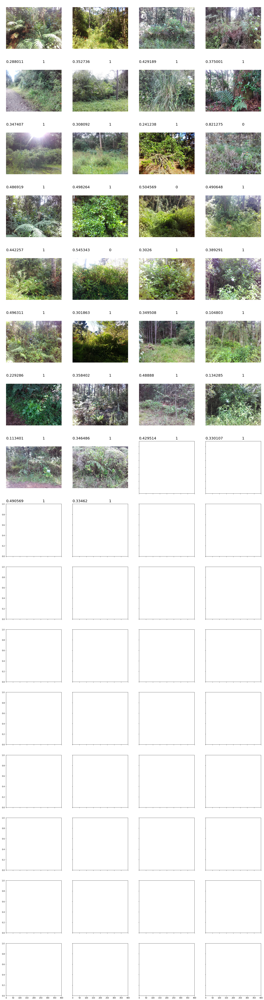

In [110]:
train_img_bad = [train_img[idx] for idx in sig_diff_idxs]
pred_labels_bad = [preds[idx] for idx in sig_diff_idxs]
actual_labels_bad = [train_labels[idx] for idx in sig_diff_idxs]

_ , ax = plt.subplots(16, 4, sharex='col', sharey='row', figsize=(25, 100))
for i, img in enumerate(train_img_bad[:64]):
        pred_label = pred_labels_bad[i]
        actual_label = actual_labels_bad[i]
        ax[i//4][i%4].imshow(img)
        ax[i//4][i%4].annotate(pred_label[0],
                      (0,0), (0, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].annotate(actual_label,
                      (0,0), (200, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].axis('off')

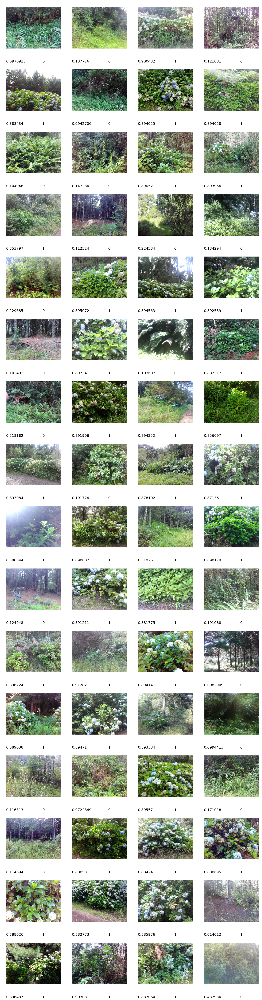

In [111]:
train_img_good = [train_img[idx] for idx in insig_diff_idxs]
pred_labels_good = [preds[idx] for idx in insig_diff_idxs]
actual_labels_good = [train_labels[idx] for idx in insig_diff_idxs]

_ , ax = plt.subplots(16, 4, sharex='col', sharey='row', figsize=(25, 100))
for i, img in enumerate(train_img_good[:64]):
        pred_label = pred_labels_good[i]
        actual_label = actual_labels_good[i]
        ax[i//4][i%4].imshow(img)
        ax[i//4][i%4].annotate(pred_label[0],
                      (0,0), (0, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].annotate(actual_label,
                      (0,0), (200, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].axis('off')

In [112]:
roc_auc_score(train_labels, preds), log_loss(train_labels, preds)

(0.99852175699739742, 0.1531322390336162)

In [113]:
preds_round = [1.0 if pred >=0.4 else 0.0 for pred in preds]
roc_auc_score(train_labels, preds_round), log_loss(train_labels, preds_round)

(0.99024261775391864, 0.36119190895966874)

In [114]:
# lets try rescaled preds
preds_rescaled = MinMaxScaler(feature_range=(0.01,0.99)).fit_transform(preds.reshape(-1, 1))
print(preds_rescaled)
roc_auc_score(train_labels, preds_rescaled), log_loss(train_labels, preds_rescaled)

[[ 0.10929916]
 [ 0.15182942]
 [ 0.96102005]
 ..., 
 [ 0.72524208]
 [ 0.94238955]
 [ 0.95995849]]


(0.99852175699739742, 0.11806610081109475)

it looks like i see very few 0.99 and a lot of 0.90-ish for 1.0 labels. i also see very few 0.00X predictions and a lot of 0.10-sh predictions for 0.0 labels. it could be because the images are noisy and the neural net has trouble saying 'yeah this big green blob is different from other green blobs' we could do LABEL SMOOTHING reduce label space from 0 - 1 to 0.10 - 0.9 for training. this would probably improve performance. i think from now on it will be important to just try thing on like one model and see if it improves performance. 


another thing we might try is to **rescale predictions to be between 0 - 1** we could probably even do both these things. label smoothing to improve training, then rescaling to match the submission range.

another thing i've noticed is that often in the hard to detect sent we have a 1 label that our model predicts between 0.4-0.6 for a 1 label that is in the 'hard to detect set' hydrangea without flowers, we might see a preformance boost by sounding everything above 0.4 up to a 0.9999 (or 1) and everything below to a 0.0001 or 0.

another thing i might try is an attention mechanism. many of the hard to detect 1 laebls seems to either be a small plant or a plant or a plant in a small part of the image which might make it harder to detect, especiall yif it isnt flowering and all we need to go on is leaf shape. basically we want somethign that will coax out features of leaf shape.

it may be easire to just split the images into sub images and then try to predict te sub-image invasive, then recombine the predictions for each image and take the max, and use that as the final prediction for the recombined image. the reason i think this will work is the following, what's happening now is this: our model says look im pretty sure this isnt hydrangea but since theres so many leaves and theyr are hard to see i can't really be sure. basically leaves are noisy and the model just can be sure, thats why all our labels are between 0.1 and 0.9 when i thinks its hydrangea its saying look i cant be sure its hydrangea because of all the leaves (0.9), and when its thinks its not hydragngea its saying look i cant be sure its not hydrangea because of all the laeves (0.1) so if we split the image into smaller parts its got fewer leaves to look at and may be able to make a very confident prediction. that very confident prediction could apply over the whole image and we label the whole thing as hydrangea.

what if we used an autoencoder to 'denoise' leaf data that wasnt in our labelled set? that could be cool.

another thing is why inception net works better than others, i think it has to do wit haverage pooling. these images are noisy (lots of leaves) so using max pooling to look for sharp features is bad. we want to use average pooling to smooth out the noisy features and let then say 'how invasive-y is this smooth blob of features' instad of trying to coax out sharp features and then asking the same question, therefore it may be wise to try average pooling. my custom inception net uses no pooling and then global avg pooling at the end. 

i thin kwhat made the original custom ensemble so powerful was that it used images of different sizes. 
we should take this to the extreme again once i figure out how to jack up the models perofmance. we should train
3 5 fold inception nets (15 total) using label smoothing(0-0.9 or 0.1-0.9), image splitting (if it works) and whatever else and then train models for 200x300, 300x400, 400x500 images.


ok so after this quick eda we have a few things to try:

1 - label smoothing during training (thir works 0.1-0.9 but maybe 0 - 0.9 is better. trying that next.)

2 - rescaling predictions after training to boost score (this works, aroc is the same but loss is lower significatnly by about 30%)

3 - rounding everything fro 0.4 up and everything below 0.4 down. (does not work)

4 - average pooling (seems to have little effect, but maybe in an ensemble its good?)

were kinda alreayd doing 4 (at least for inception), we need to do 3 and 1 not at the same time to see their effects, we can do 2, 3 afterwards easily.

# more thoughts

we could make a model that predicts the probability of invasive (like my custom inception model), then create global image feature extractions, then make a new model, it takes the ppredicted probability of invasive and global feature descriptors and makes a new prediction (like here: https://gogul09.github.io/software/flower-recognition)

a fianl ensemble might be:

inception net custom,
inception net dense ft,
global feature extractor + predictions model

# invasive_customincep_aug8_0.model (0.1 - 0.9 label smoothing)

In [85]:
model_path = os.path.join(path,'invasive_customincep_aug8_0.model')
model = load_model(model_path)

In [86]:
#inception model did preproecss images but it was trained on regular images.
proc_train_img = preprocess_input_incep_xcep(train_img.astype(np.float32))
smoothed_train_labels = np.array([np.round(label, decimals=2) if label else np.round(label+0.10, decimals=2) for label in np.multiply(0.9, train_labels)])
model.evaluate(proc_train_img, smoothed_train_labels)

2295/2295 [==============================] - 27s     

0.35017726427849083

remember this is the loss relative to the smoothed labels, if we compare loss to the actual labels that
will tell us whether the labels smoothing worked.

In [87]:
preds = model.predict(proc_train_img)
diffs = np.abs(smoothed_train_labels - preds.flatten())

In [88]:
# this is the number that willbe misclassified here its only 20, before was 34
# explains the boost to aroc
sig_diff_idxs = np.array([i for i,diff in enumerate(diffs) if diff > 0.5])
sig_diff_idxs.shape

(20,)

In [89]:
# this is the number that will be correctly classified.
insig_diff_idxs = np.array([i for i,diff in enumerate(diffs) if diff < 0.5])
insig_diff_idxs.shape

(2275,)

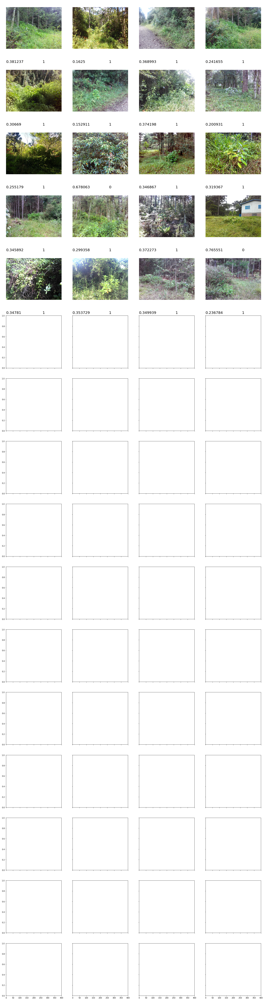

In [90]:
train_img_bad = [train_img[idx] for idx in sig_diff_idxs]
pred_labels_bad = [preds[idx] for idx in sig_diff_idxs]
actual_labels_bad = [train_labels[idx] for idx in sig_diff_idxs]

_ , ax = plt.subplots(16, 4, sharex='col', sharey='row', figsize=(25, 100))
for i, img in enumerate(train_img_bad[:64]):
        pred_label = pred_labels_bad[i]
        actual_label = actual_labels_bad[i]
        ax[i//4][i%4].imshow(img)
        ax[i//4][i%4].annotate(pred_label[0],
                      (0,0), (0, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].annotate(actual_label,
                      (0,0), (200, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].axis('off')

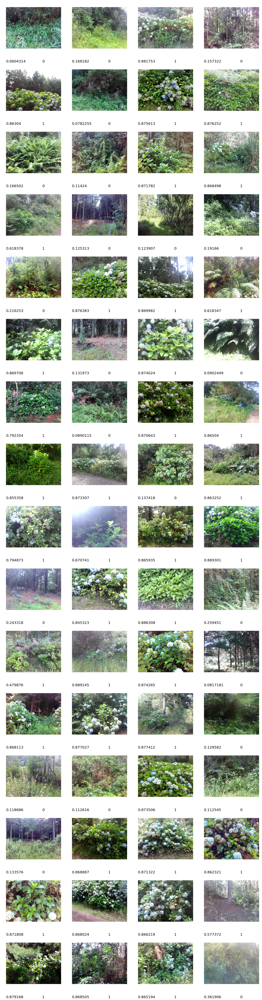

In [91]:
train_img_good = [train_img[idx] for idx in insig_diff_idxs]
pred_labels_good = [preds[idx] for idx in insig_diff_idxs]
actual_labels_good = [train_labels[idx] for idx in insig_diff_idxs]

_ , ax = plt.subplots(16, 4, sharex='col', sharey='row', figsize=(25, 100))
for i, img in enumerate(train_img_good[:64]):
        pred_label = pred_labels_good[i]
        actual_label = actual_labels_good[i]
        ax[i//4][i%4].imshow(img)
        ax[i//4][i%4].annotate(pred_label[0],
                      (0,0), (0, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].annotate(actual_label,
                      (0,0), (200, -32), xycoords='axes fraction', 
                       textcoords='offset points', va='top', size=20)
        ax[i//4][i%4].axis('off')

# thoughts cont.

once we try a bunch of stuff and improve models. we can throw them at 100 epochs of train time * 7 folds. and ensemble. but we want to get each model producing something good first. conv, resnet, inception, we dont want to throw shitty models at lots of train time.

the blue house is classified as 70% hydrangea because of its blue roof ....

it would be really cool if when we split up the image it wouldnt be just the max value that determines hydrangea probability but talso thatthe minimum must be a certain baseline?

In [92]:
roc_auc_score(train_labels, preds), log_loss(train_labels, preds)

(0.99921644151930433, 0.16935600788375132)

ok so the label smoothing appears to have generated a log loss (0.169) that is slightly higher than the original (0.15) BUT with label smoothing we seem to have reduced the # of images that differ from their label by more than 0.5 from 34 to now only 20. this shows as a highre aroc score (0.9992) vs (0.9985) and that's great.

In [93]:
# lets try to see what our accuracy if we reduce limit to 0.4
preds_round = [1.0 if pred >=0.4 else 0.0 for pred in preds]
roc_auc_score(train_labels, preds_round), log_loss(train_labels, preds_round)

(0.99024261775391864, 0.36119190895966879)

this tries to round up the preds above 0.4 to 1.0 which actually reduces both aroc and incraesse loss. so that's probabliy bad, it also ends up the same as the aug7 models aroc and loss if i round them.

In [104]:
# lets try rescaled preds
preds_rescaled = MinMaxScaler(feature_range=(0.01,0.99)).fit_transform(preds.reshape(-1, 1))
print(preds_rescaled)
roc_auc_score(train_labels, preds_rescaled), log_loss(train_labels, preds_rescaled)

[[ 0.03645312]
 [ 0.15812574]
 [ 0.96389735]
 ..., 
 [ 0.84654737]
 [ 0.94477481]
 [ 0.95908928]]


(0.99921644151930433, 0.10921769089639706)

wow rescaling the label smoothed preds to between 0.01 and 0.99 reduces the loss quite a bit, even lower than without label smoothing. its very likely that label smoothing 0.1-0.9 is really good.

important to remember these numbers are not for all the 5 folds just the 0th fold. other folds may be better in some ways and worest in others. this aroc score is really weird. it is impervious to changes in the labels. it seems to be a mesaure of how any were correct more of less. you can round things up and down to 0 and 1 and still get the same aroc.

In [119]:
#these roughly match our arocs and
#the number we got wrong
100 - (30 / 2295), 100 - (20 / 2295)

(99.98692810457516, 99.99128540305011)

so aroc is basically a measure of how many were worng when converted to 1s and 0s. in otherwords, to get a higher aroc you need to reduce the number of wrong examples 9or examples off by more tahn 0.5 from their target label.

# things to try cont.

1 - data augmentation (but only when the model is really well tuned already)

2 - autoencoder to denoise leaf data that isnt hydrangea (train a model on the 0 labels then use taht model to denoise all the training data, sort of like subtracting the pixel mean of the 0 labels)

3 - image splitting/attention max probablilty mechanism (trying on resnet) 